# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---


## Computing the camera calibration using chessboard images

The first step in this project is getting of distortion caused by camera by applying camera calibration function provided by OpenCV. 
Camera distortion affects some visual characteristics of the objects in the image, it can make a straight lines look curved which will give wrong assumptions about lanes and objects.

To perform Camera Calibration using a chessboard pattern. First we have to prepare the points coordinates that present the coordinates of the chessboard's squares corners. Then we loop through each image, convert it to a grayscale, and apply findChessboardCorners function to find the chessboard corners. After that we use all the points that we found to calibrate the camera using   calibrateCamera() function, the output of the calibration that we need  is two matrices; the calibration matrix and distortion.

Check the following code to see how we Implement the steps:


In [89]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
#%matplotlib qt
%matplotlib inline 
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)


## Saving the camera parameters to be used next time
I found it useful to use Pickle library to save data in python. I used it to save the  calibration matrix and distortion  for the camera, so I can just load it from the disk an proceed..., Here is how I used it:


In [90]:
import pickle
cameraCal = {'mtx': mtx , 'dist':dist}
pickle.dump( cameraCal, open( "camera.p", "wb" ) )
# Read in the saved objpoints and imgpoints

## You can start here, camera is already calibrated and saved in camera.p file
As the camera calibration matrices are saved, I can simply start from this point by loading the saved matrices.


In [91]:
import pickle
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
#%matplotlib qt
%matplotlib inline 
dist_pickle = pickle.load( open( "camera.p", "rb" ) )
savedMtx = dist_pickle["mtx"]
savedDist = dist_pickle["dist"]


Here I re-defined the distortion function in a shorter version that is easier to use. Also I made a  function that plots a 2 by 1 images. The plotting function will be very useful in testing the pipeline steps. The following block shows the definition for each.

In [142]:
#define a shorter function for unditrotion 
def unDisImg (img,mtx,dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

#define side by side plotting function    
def subPlot1by2(img1,img2, title = "Processed Image"):
    if len(img1.shape)>2:
        img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    if len(img2.shape)>2:
        img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img1)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(img2)
    ax2.set_title(title, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Camera Calibration Testing 
Here I using the previously defined  function to test and show the result of camera distortion.


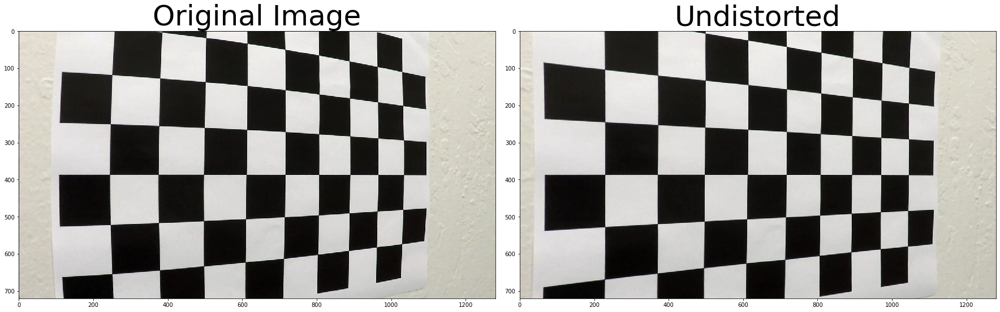

In [93]:
testCal = cv2.imread('./camera_cal/calibration5.jpg')
subPlot1by2(testCal,unDisImg(testCal,savedMtx,savedDist),'Undistorted')

# Lane Preprocessing Functions

The following show the functions used to extract and mask the left and right lanes pixels. The final function combinedThresholds() combines all the other extracted masks in a single mask trying to get the best result. 

### The used filtering masks are:
- gradient absolute value
    - in x and y directions 
- gradient magnitude
- gradient direction
- Color masks one HLS space: 
    - for yellow lane 
    - for white lane 

All these binary masks are combined in diffrent ways to strengthen the final binary mask. You can see use one of the 
 -  **'gradients':**
        combines all the gradients as:
            gradients[((gradx == 1) & (grady == 1) ) | ((mag_binary == 1) & (dir_binary == 1))] = 1

 -  **'colours':**
        combines the two colour masks:
        colour[((lMask == 1) | (sMask == 1))] = 1

 - **'all-OR':**
        combined[(gradients == 1) | (colour == 1)] = 1  
 - **'all-AND':**
        combined[(gradients == 1) & (colour == 1)] = 1
 - **'all-A':**
        combined[ ((lMask == 1) | (sMask == 1)) | ((gradx == 1) & (mag_binary == 1) & (dir_binary == 1) )] = 1 
        
  Check the block below for the Implementation details:


In [3]:
def combinedThresholds(img, HLS = 0 , Mode = 'all-OR'):
    # Apply each of the thresholding functions--
    ksize = 7
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    if HLS:
        img = hls[:,:,2]    
    gradx = absSobelThresh(img, orient='x', sobel_kernel=ksize, absThresh=(20,100 ))
    grady = absSobelThresh(img, orient='y', sobel_kernel=ksize, absThresh=(20,100 ))
    mag_binary = magThresh(img, sobel_kernel=ksize, magThresh=(20, 100))
    dir_binary = dirThreshold(img, sobel_kernel=ksize, dirThresh=(0.7,1.3))
    
    lMask = colourMask(hls[:,:,1], threshold=(200, 255))
    sMask = colourMask(hls[:,:,2], threshold=(170, 255))
    gradients = np.zeros_like(dir_binary)
    gradients[((gradx == 1) & (grady == 1) ) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    colour = np.zeros_like(dir_binary)
    colour[((lMask == 1) | (sMask == 1))] = 1
    combined = np.zeros_like(dir_binary)
    if Mode == 'gradients':
        combined[(gradients == 1)] = 1
    if Mode == 'colours':
        combined[ (colour == 1)] = 1 
    if Mode == 'all-OR':
        combined[(gradients == 1) | (colour == 1)] = 1  
    if Mode == 'all-AND':
        combined[(gradients == 1) & (colour == 1)] = 1
    if Mode == 'all-A':
        combined[ ((lMask == 1) | (sMask == 1)) | ((gradx == 1) & (mag_binary == 1) & (dir_binary == 1) )] = 1 
    return combined

def absSobelThresh(img, orient='x',sobel_kernel=3, absThresh=(20,100 )):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape)>2:
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient=='x':
        soble = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    if orient=='y':
        soble = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel)
    # 3) Take the absolute value of the derivative or gradient
    absSoble = np.absolute(soble) 
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaledSoble = np.uint8(absSoble*255/(np.max(absSoble)))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
    masked = np.zeros_like(scaledSoble)
            # is > thresh_min and < thresh_max
    masked [(scaledSoble > absThresh[0]) & (scaledSoble < absThresh[1])] = 1

    return masked

def magThresh(img, sobel_kernel=3, magThresh=(30, 100)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape)>2:
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    # 2) Take the gradient in x and y separately
    sobelX = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobelY = cv2.Sobel(gray, cv2.CV_64F, 0,1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    sobelMag = np.sqrt(sobelX**2 + sobelY**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaledMag = np.uint8(255*sobelMag/np.max(sobelMag))
    # 5) Create a binary mask where mag thresholds are met
    mask = np.zeros_like(scaledMag)
    # 6) Return this mask as your binary_output image
    mask [ (scaledMag >=  magThresh[0]) & (scaledMag <=  magThresh[1]) ]  = 1
    return mask

def dirThreshold(img, sobel_kernel=3, dirThresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape)>2:
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    # 2) Take the gradient in x and y separately
    sobelX = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel )
    sobelY = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel )
    absSobelX = np.absolute(sobelX)
    absSobelY = np.absolute(sobelY)

    # 3) Take the absolute value of the x and y gradients
    sobelMAg = np.sqrt(sobelX**2 + sobelY**2)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    sobelDir = np.arctan2(absSobelY, absSobelX)
    # 5) Create a binary mask where direction thresholds are met
    mask = np.zeros_like(sobelDir)
    mask[(sobelDir >= dirThresh[0]) & (sobelDir <= dirThresh[1]) ] = 1
    # 6) Return this mask as your binary_output image
    return mask

def colourMask(img, threshold=(0, 255)):
    mask = np.zeros_like(img)
    mask[(img >= threshold[0]) & (img <= threshold[1])] = 1
    return mask



## Testing each preprocessing function alone:
Reading image test2.jpg then applying the diffrent function and showing the output

In [28]:
testImg = cv2.imread('./test_images/test2.jpg')

### Testing gradient absolute value
First in the 'x' direction

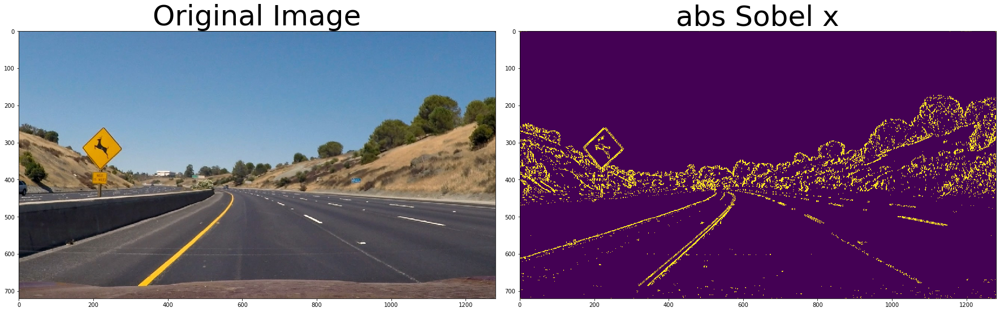

In [14]:

subPlot1by2(testImg,absSobelThresh(testImg, orient='x', absThresh=(20,100 )), 'abs Sobel x')

Then in the 'y' direction

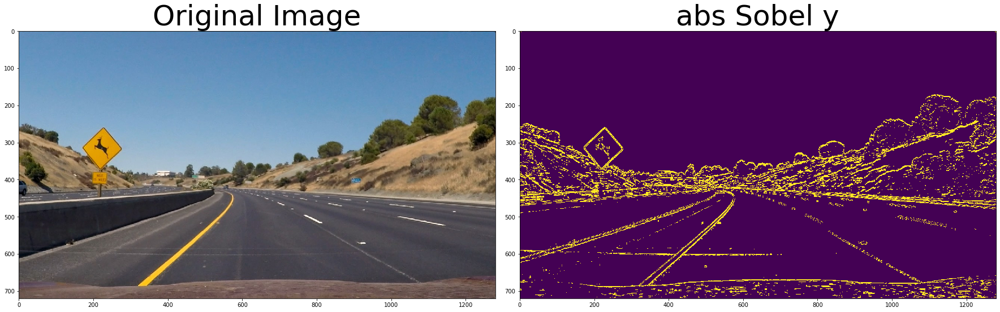

In [15]:
subPlot1by2(testImg,absSobelThresh(testImg, orient='y', absThresh=(20,100 )), 'abs Sobel y')

### Testing gradient magnitude function


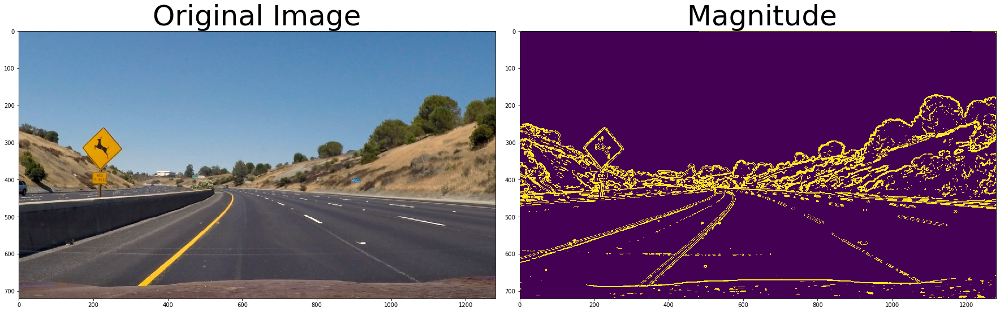

In [96]:
subPlot1by2(testImg,magThresh(testImg, sobel_kernel=7, magThresh=(30, 100)),' Magnitude')

### Testing gradient direction function

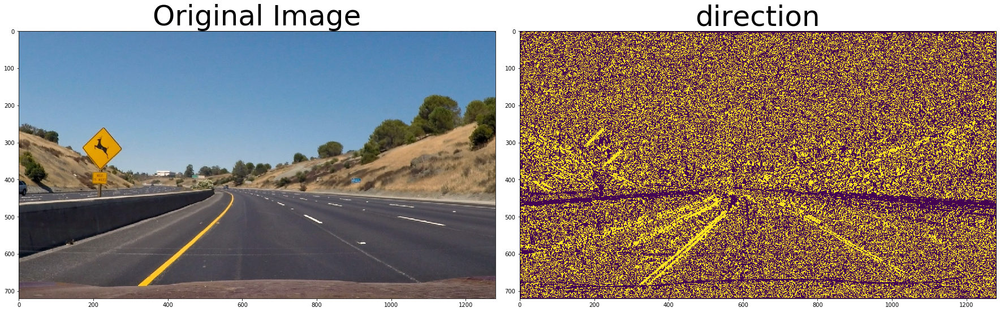

In [17]:
subPlot1by2(testImg,dirThreshold(testImg, 7, (0.7,1.3)), 'direction')

## Calibrating the threshold for the Yellow and White Lanes

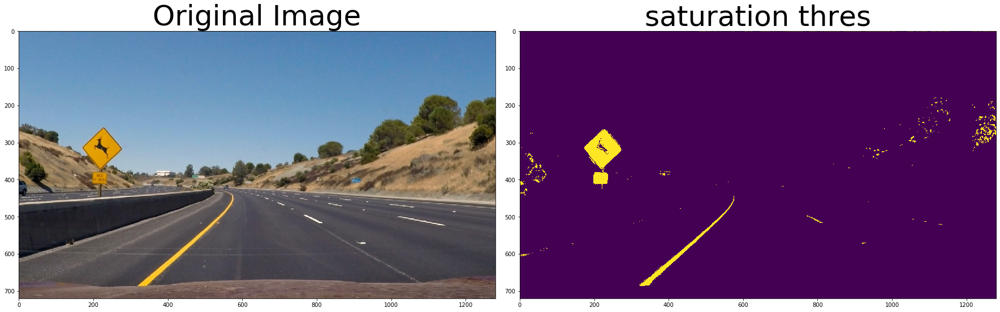

In [18]:
img = cv2.cvtColor(testImg, cv2.COLOR_BGR2HLS)[:,:,2]

subPlot1by2(testImg,colourMask(img, threshold=(170, 255)), 'saturation thres')

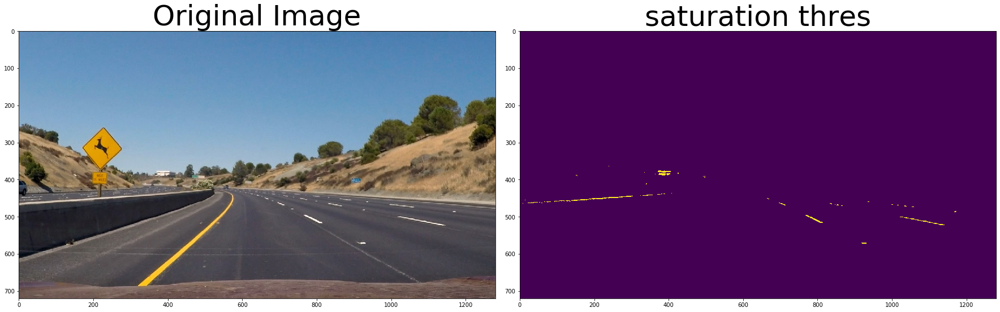

In [19]:
img = cv2.cvtColor(testImg, cv2.COLOR_BGR2HLS)[:,:,1]
subPlot1by2(testImg,colourMask(img, threshold=(200, 255)), 'saturation thres')

### Testing the final combination with the diffrent options introduced before

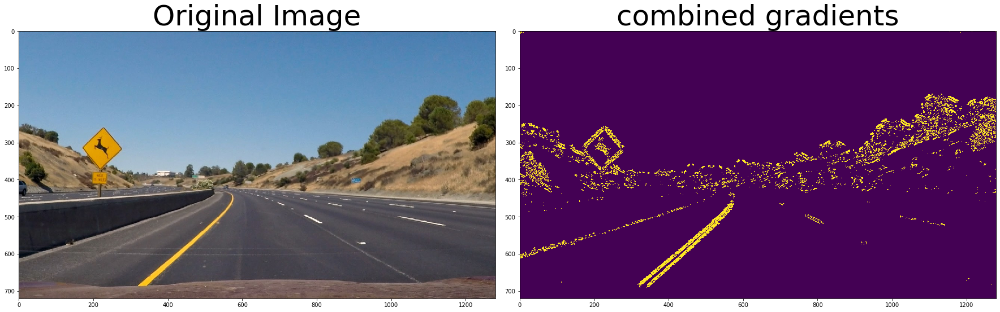

In [21]:
subPlot1by2(testImg,combinedThresholds(testImg, HLS = 1, Mode = 'gradients'), 'combined gradients')

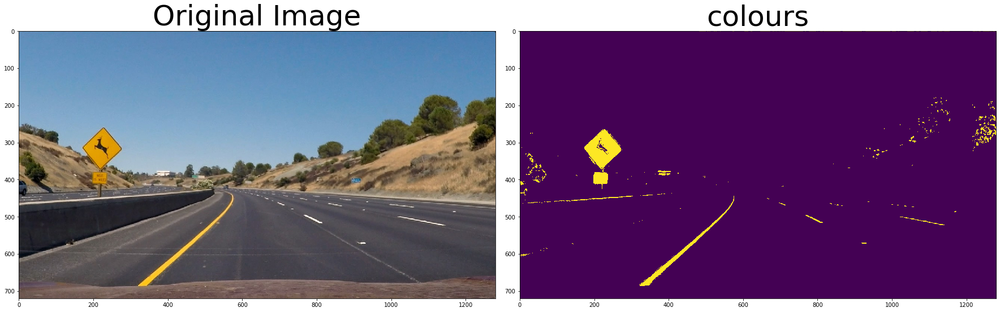

In [23]:
subPlot1by2(testImg,combinedThresholds(testImg, HLS = 1, Mode = 'colours'), 'colours')

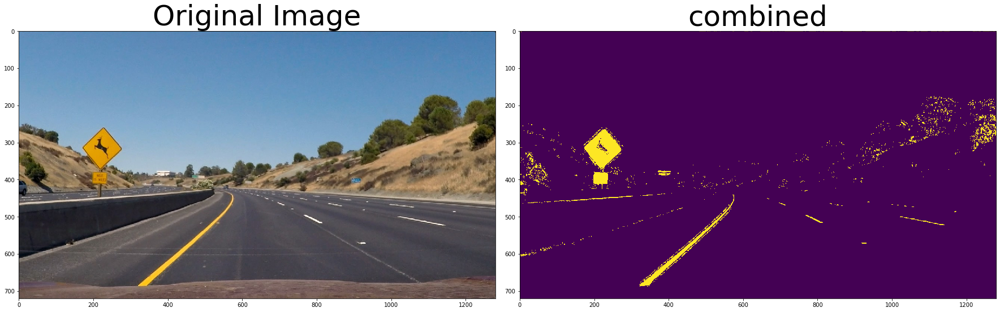

In [22]:
subPlot1by2(testImg,combinedThresholds(testImg, HLS = 1, Mode = 'all-A'), 'combined')

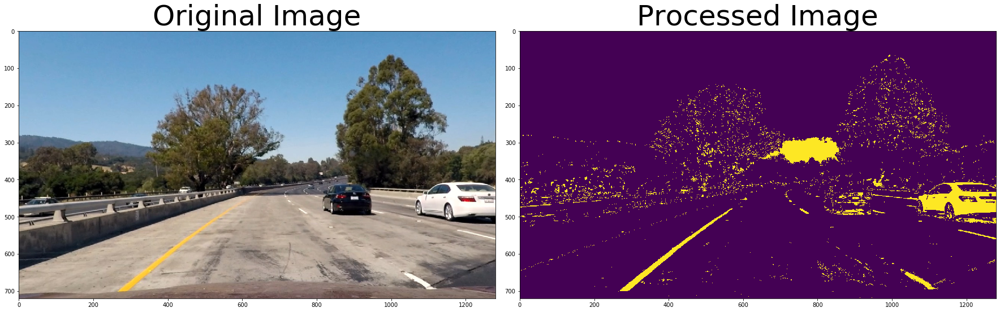

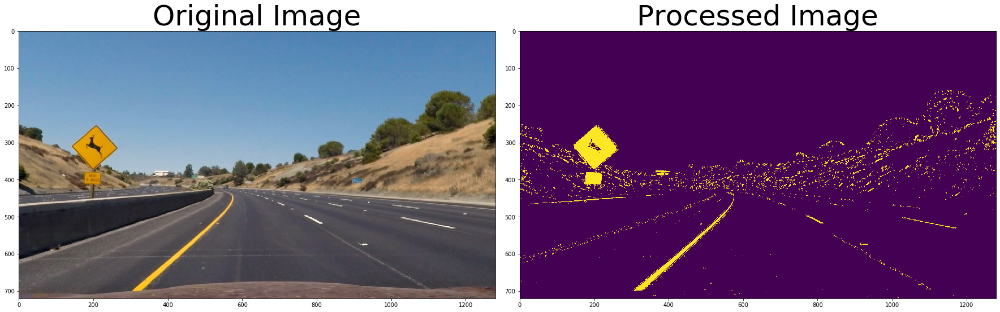

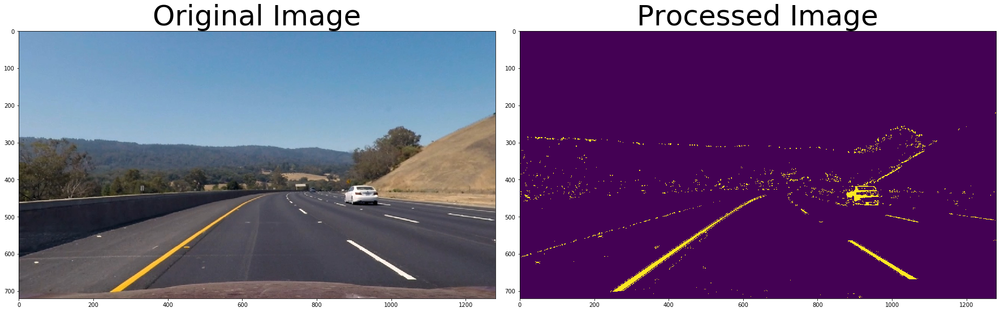

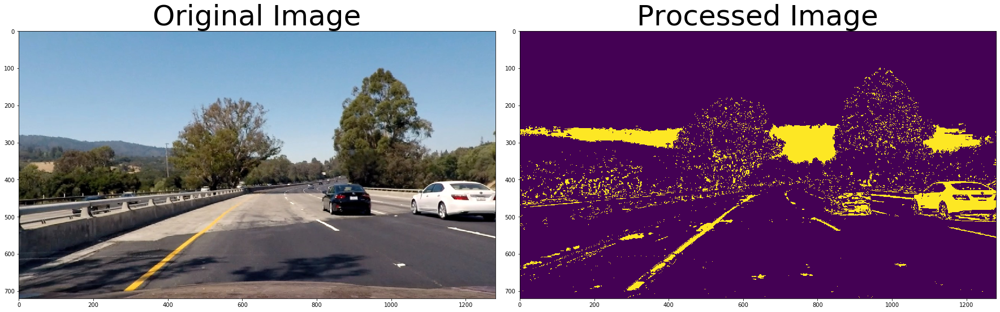

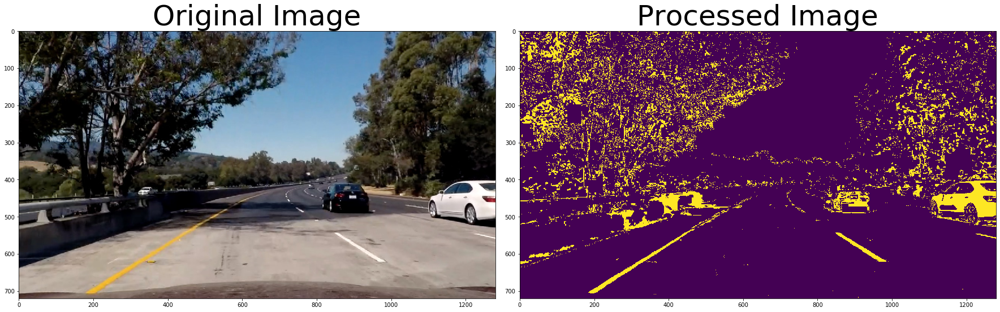

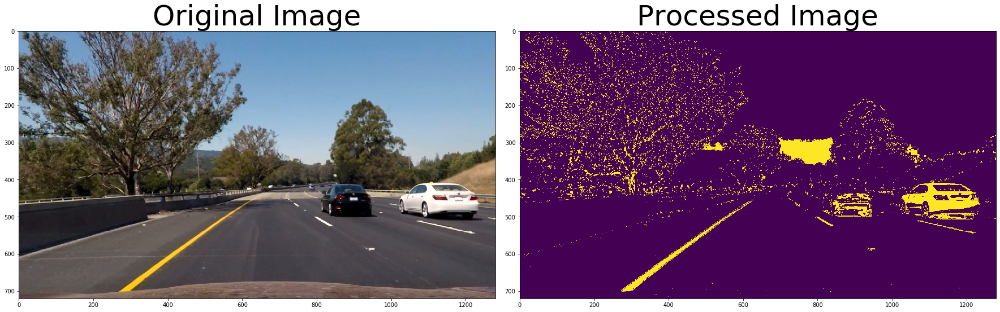

In [24]:
for image in glob.glob('./test_images/test*.jpg'):
    image = unDisImg(cv2.imread(image),savedMtx,savedDist)
    filteredLanes = combinedThresholds(image, HLS = 0 , Mode = 'all-A')
    subPlot1by2(image,filteredLanes)

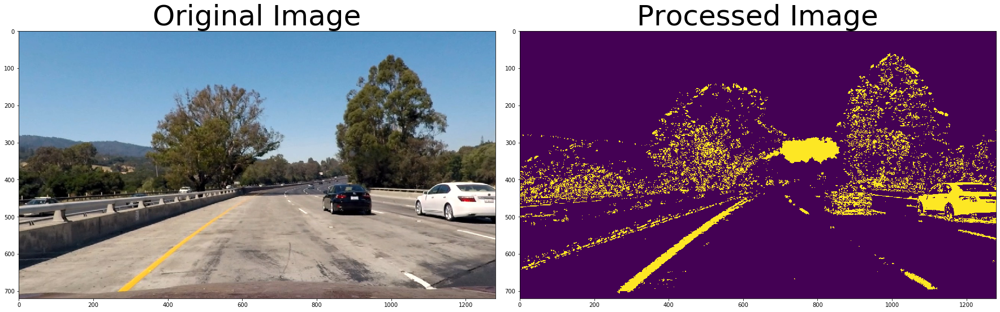

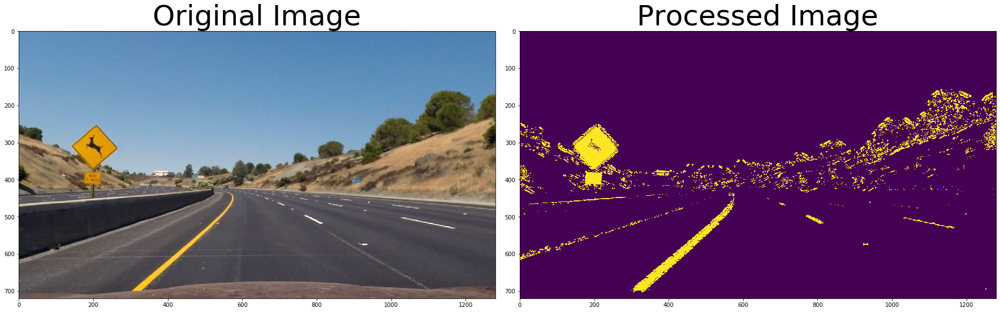

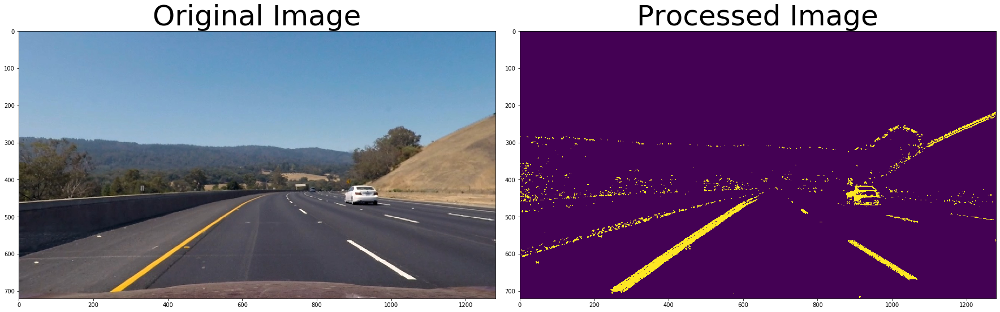

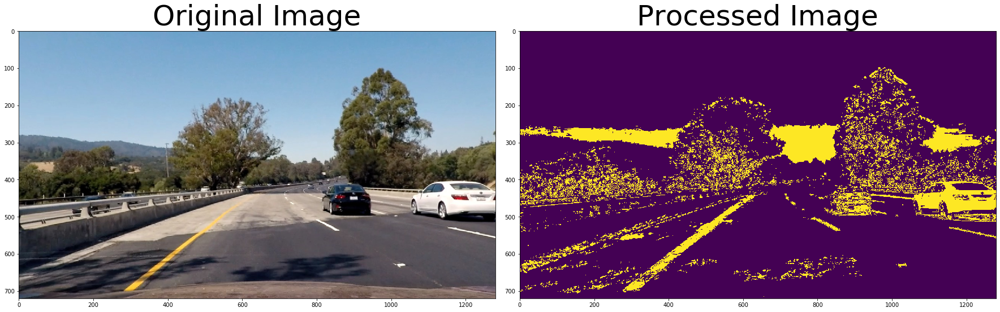

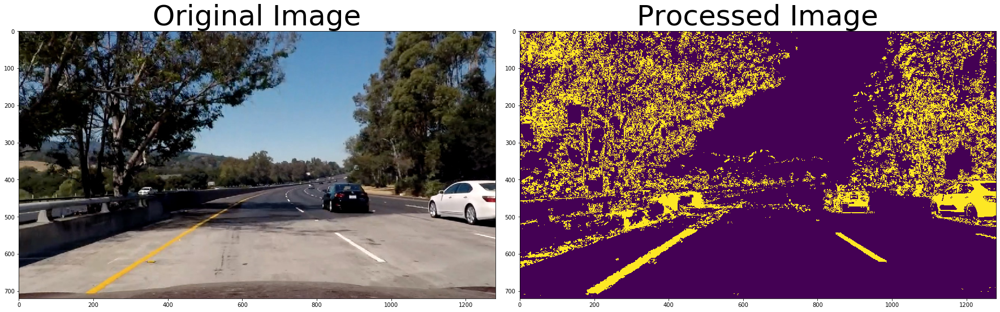

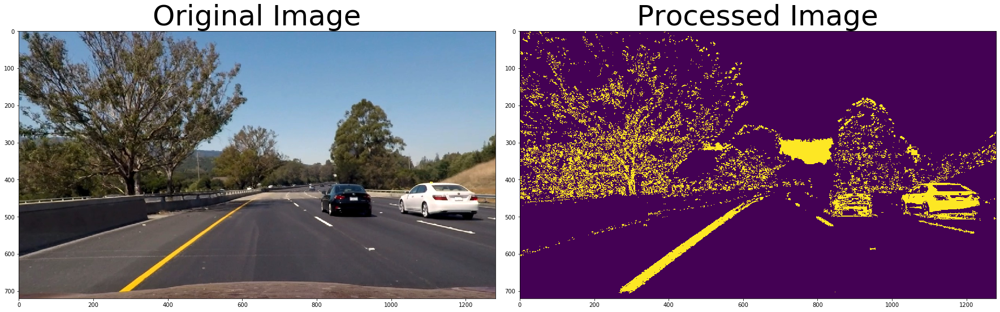

In [25]:
for image in glob.glob('./test_images/test*.jpg'):
    image = unDisImg(cv2.imread(image),savedMtx,savedDist)
    filteredLanes = combinedThresholds(image, HLS = 1 , Mode = 'all-OR')
    subPlot1by2(image,filteredLanes)

# Lane Preprocessing Functions

The following show the functions used to extract and mask the left and right lanes pixels. The final function combinedThresholds() combines all the other extracted masks in a single mask trying to get the best result. 

### The used filtering masks are:
- gradient absolute value
    - in x and y directions 
- gradient magnitude
- gradient direction
- Color masks one HLS space: 
    - for yellow lane 
    - for white lane 

All these binary masks are combined in different ways to strengthen the final binary mask. You can see use one of the 
 -  **'gradients':**
        combines all the gradients as:
            gradients[((gradx == 1) & (grady == 1) ) | ((mag_binary == 1) & (dir_binary == 1))] = 1

 -  **'colors':**
        combines the two colour masks:
        colour[((lMask == 1) | (sMask == 1))] = 1

 - **'all-OR':**
        combined[(gradients == 1) | (colour == 1)] = 1  
 - **'all-AND':**
        combined[(gradients == 1) & (colour == 1)] = 1
 - **'all-A':**
        combined[ ((lMask == 1) | (sMask == 1)) | ((gradx == 1) & (mag_binary == 1) & (dir_binary == 1) )] = 1 
        
  Check the block below for the Implementation details:


In [29]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

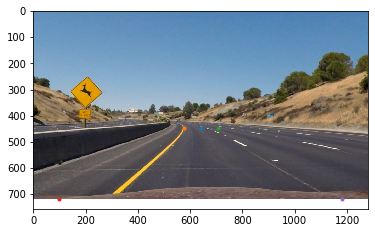

In [34]:
height, width = testImg.shape[:2] 
Ytop = height * 0.62
undistorted = unDisImg(testImg,savedMtx,savedDist)
topL = [width // 2 - 65, Ytop]
topR = [width // 2 + 65, Ytop]
btmR = [width -50, height]
btmL = [50, height]

plt.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
plt.plot(width // 2 , Ytop,'.')
plt.plot(width // 2 - 65, Ytop,'.')
plt.plot(width // 2 + 65, Ytop,'.')
plt.plot(100, height,'.')
plt.plot(width -100 , height,'.')
vertices = np.array([[topL, topR, btmR, btmL]], dtype=np.int32)
#region_of_interest(undistorted, vertices)
#subPlot1by2(undistorted,region_of_interest(undistorted, vertices))




After choosing the point, I am visualizing the regions for the test images to see If the lane line are cropped or within the processing region.

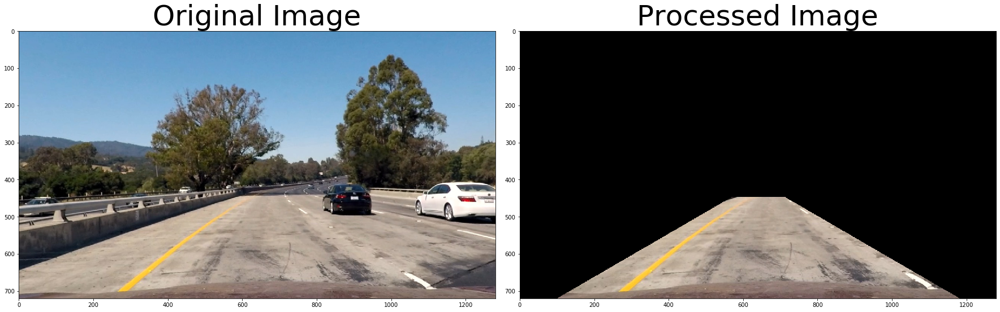

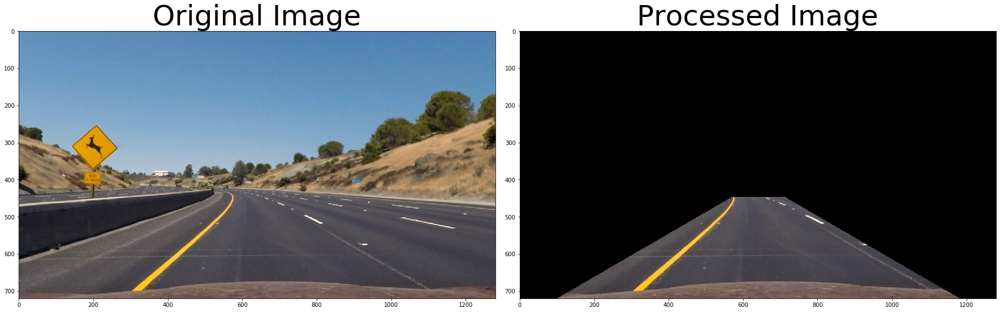

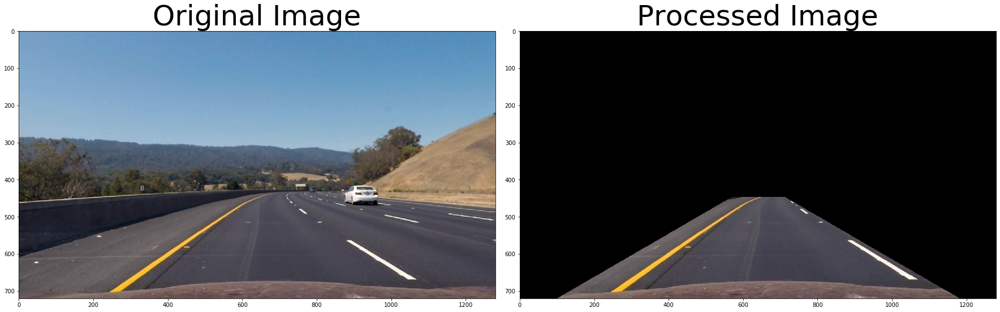

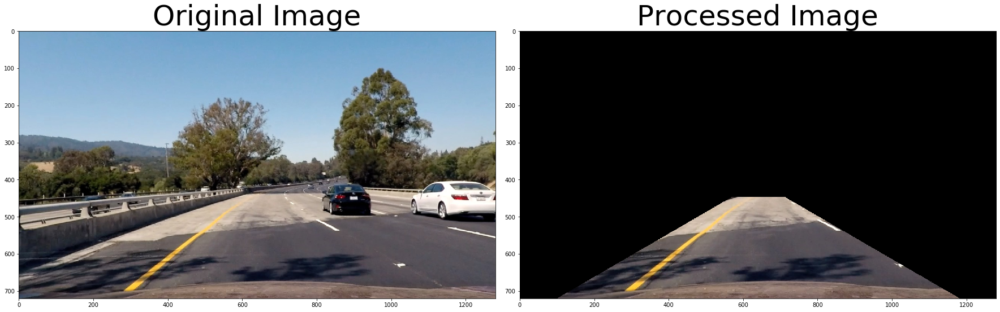

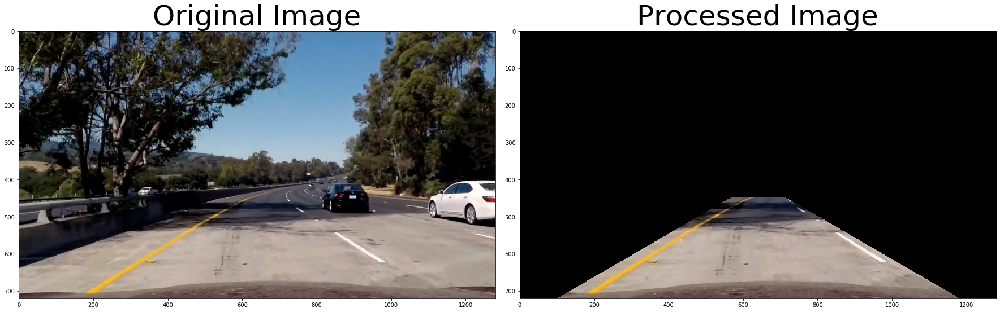

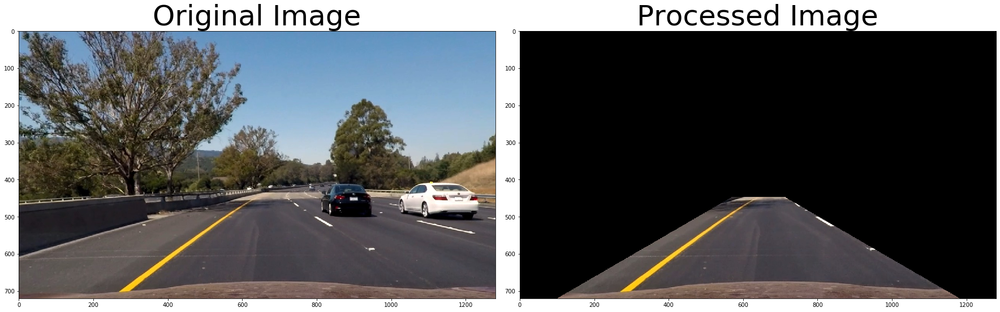

In [33]:
for image in glob.glob('test_images/test*.jpg'):
    image = unDisImg(cv2.imread(image),savedMtx,savedDist)
    subPlot1by2(image,region_of_interest(image, vertices))

Here I'll find the Perspective transform Matrix between the ROI and the top view of the road using perspective_transform(), I also defined the warpedImage() function that perform the transform

In [75]:

def perspective_transform(image,depth = 0.62 ):
    height, width = image.shape[:2]
    Ytop = height * depth
    # verties coordinates in the source image
    topLsrc = [width // 2 - 65, Ytop]
    topRsrc = [width // 2 + 65, Ytop]
    btmRsrc = [width -50, height]
    btmLsrc = [50, height]
    src = np.float32([topLsrc, topRsrc, btmRsrc, btmLsrc])
    #  verties coordinates in the Warpped image
    topLdst = [100,-0]
    topRdst = [width -100 , 0]
    btmRdst = [width -100 , height]
    btmLdst = [100, height]

    dst = np.float32([topLdst, topRdst, btmRdst, btmLdst])
    # perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
 
    # Warp the image
   
    # We also calculate the oposite transform
    unwrap_m = cv2.getPerspectiveTransform(dst, src)
    return (M, unwrap_m)

def warpedImage(image,M):
    height, width = image.shape[:2]
    warped = cv2.warpPerspective(image, M, (width, height))
    return warped

### Testing the Warp Function for all the test images

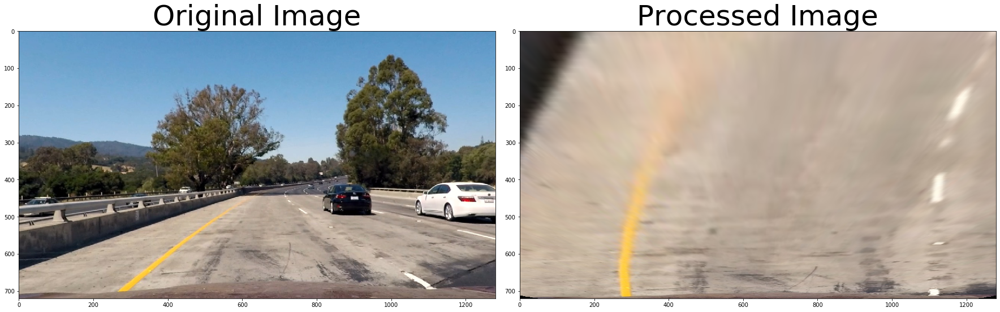

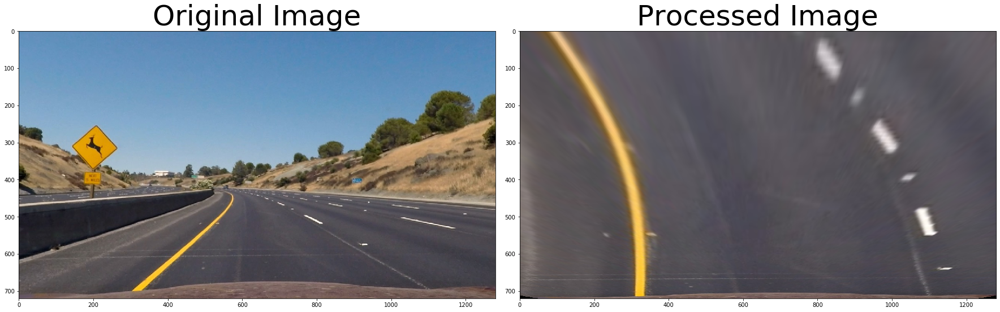

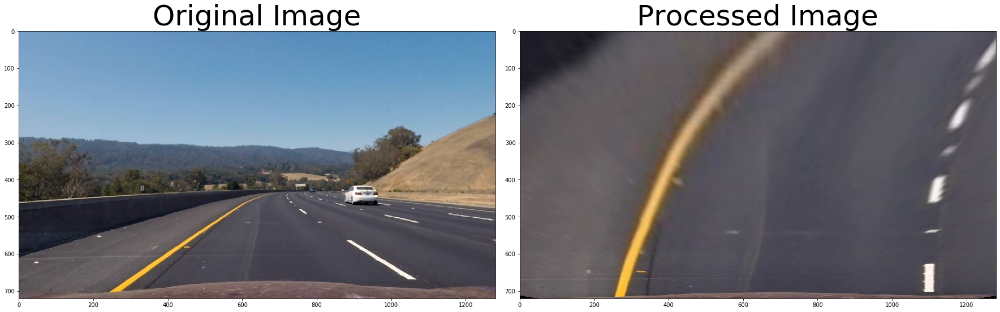

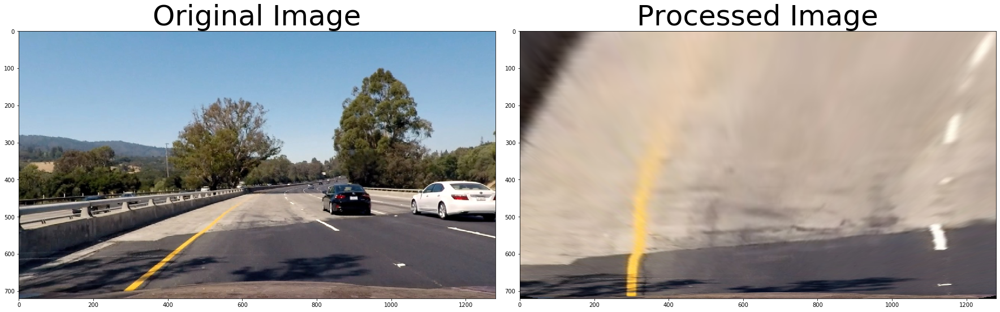

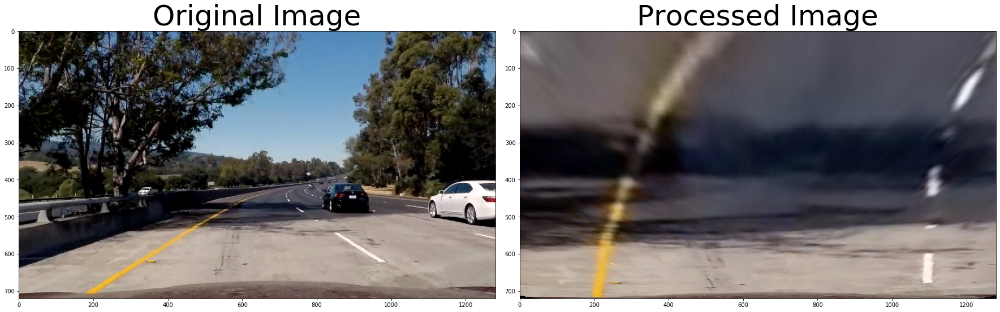

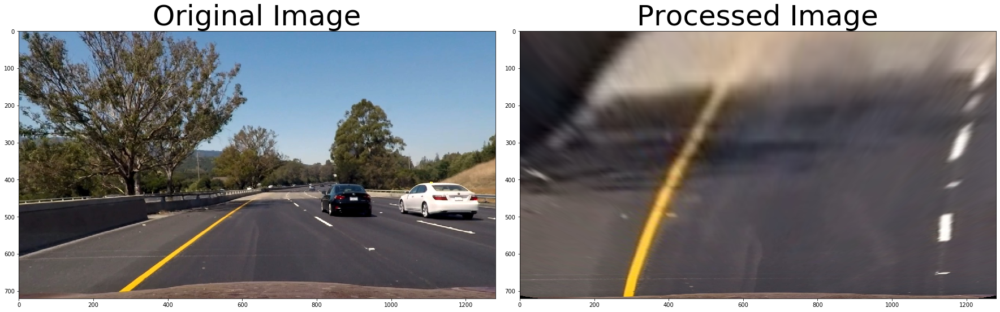

In [39]:

for image in glob.glob('test_images/test*.jpg'):
    image = unDisImg(cv2.imread(image),savedMtx,savedDist)
    M, unwrap_m = perspective_transform(image) 
    warpedImg = warpedImage(image,M)
    subPlot1by2(image,warpedImg)

### Starting the steps of building the pipeline by adding the binary mask to the prevoius process:

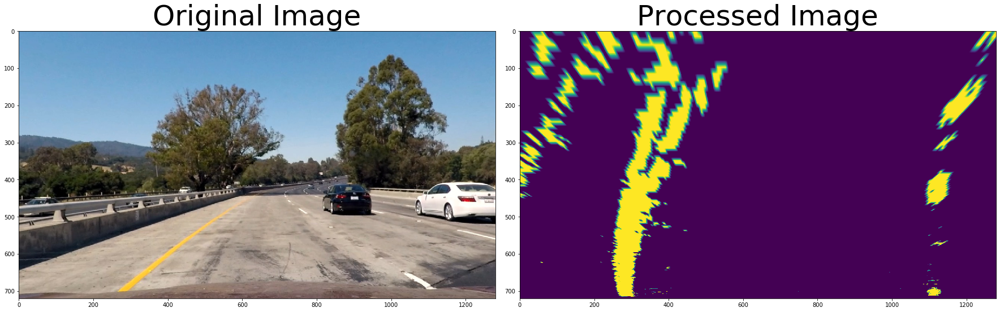

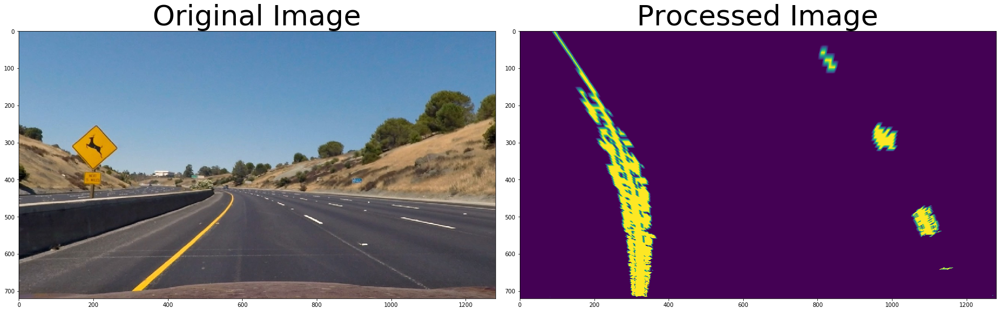

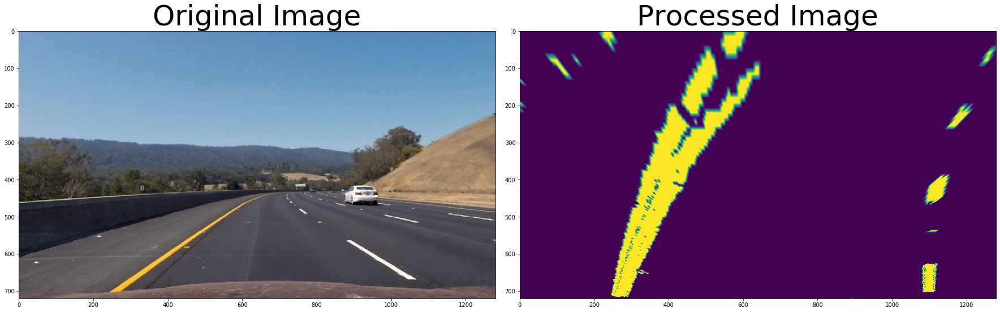

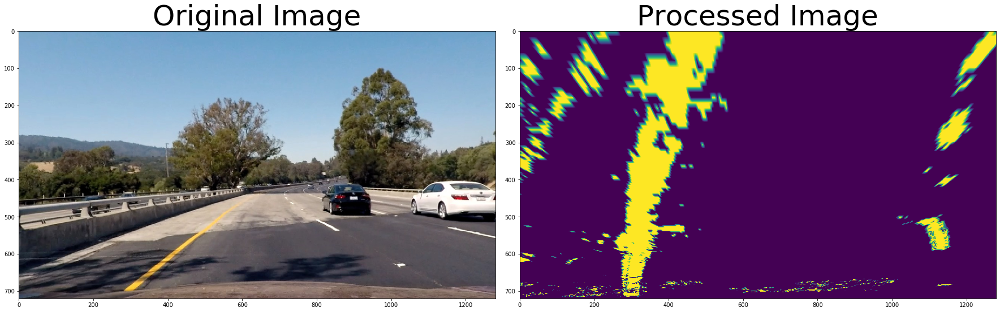

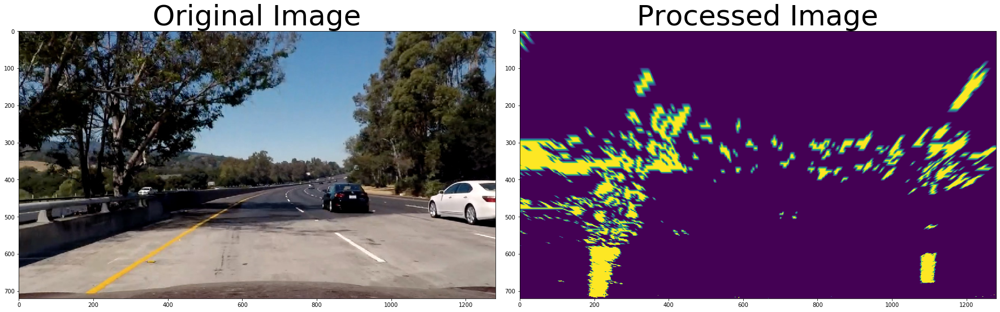

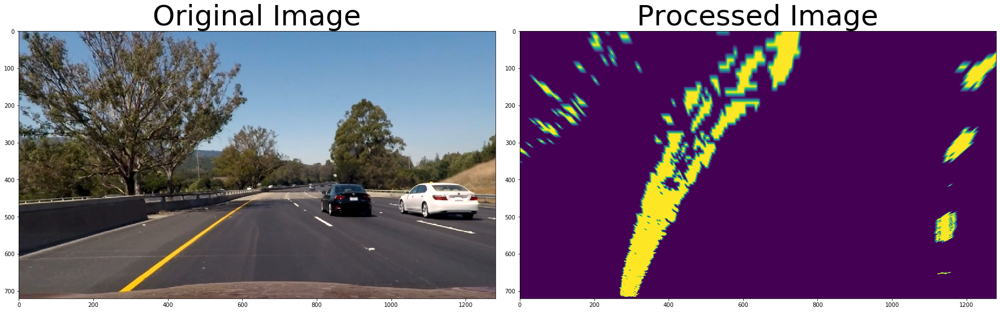

In [100]:

for image in glob.glob('test_images/test*.jpg'):
    image = unDisImg(cv2.imread(image),savedMtx,savedDist)
    masked = combinedThresholds(image, HLS = 1, Mode = 'all-OR')
    M, unwrap_m = perspective_transform(image) 
    warpedImg = warpedImage(masked,M)
    subPlot1by2(image,warpedImg)


### Lane line fitting: 

The adopted approach to define road lanes here is by finding the pecks in a histogram. The histogram is analyzed over sliding sections of the image called windows. The peak of the histogram in each window represent the lane. 
The histogram peak is located where more pixels lanes in the binary mask are located. 

The lane is first processed by creating sliding windows as in find_lane_pixels() function. Starting from the bottom of the image, the lanes starting points are defined, moving to the higher windows each window center is redefined based on the histogram peak from the previous one. The centers of the windows are then used to fit a second order polynomial describing the lane line. this process is done for the left and right lane lines.

To make the process faster in videos, the previous process is done only for the first frame, after that we can build a search window based on the lane line found in the previous frame. search_around_poly() function implements that and keeps updating the lane line in the process while processing a video.


In [58]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 40

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )

    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fitx,right_fitx, ploty, left_fit ,right_fit


def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty, left_fit,right_fit

def search_around_poly(binary_warped, left_fit,right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty,left_fit,right_fit = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array(np.transpose([left_fitx-margin, ploty])).reshape(-1,2)
    left_line_window2 = np.array(np.flipud(np.transpose([left_fitx+margin, ploty]))).reshape(-1,2)
    #print("left_line_window1",left_line_window1)

    left_line_pts = np.vstack((left_line_window1, left_line_window2))

    #print("left_line_window2",left_line_window2)
    #print("left_line_pts",left_line_pts)

    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])

    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

#     # Plot the polynomial lines onto the image
#     #plt.plot(left_fitx, ploty, color='yellow')
#     #plt.plot(right_fitx, ploty, color='yellow')
#     ## End visualization steps ##
    
    return out_img,left_fitx, right_fitx, ploty,left_fit,right_fit





## Lane Info & Lane Overlay
The following functions provides a visualization for the extracted lane info. 
measure_curvature_real() measures the lane curvature, to be honest I am not sure about the result as we don’t have a reference for the true calculations. Note that I adjusted the xm_per_pix value to 3.7/840, when I measured the lane width in pixels manually it was almost 840 pixels. 

The overlay() function, visualized the lane are in green color, while placing the curvature info in the top right corner.


In [112]:
def measure_curvature_real(ploty, left_fitx,right_fitx):
    '''
    Calculates the curvature of polynomial functions in pixels.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/840 # meters per pixel in x dimension
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix , 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    fit = 0.5 * left_fit_cr + 0.5 *right_fit_cr
   
     # Calculation of R_curve (radius of curvature)
    #left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    #right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    radius = ((1 + (2*fit[0]*y_eval*ym_per_pix + fit[1])**2)**1.5) / np.absolute(2*fit[0])
    return radius

def draw_text(frame, text, x, y):
    cv2.putText(frame, text, (x, y), cv2.FONT_HERSHEY_DUPLEX, 0.6, (255, 255, 255), 1)

def laneInfo(right_fitx,left_fitx, imgWidth):
    xm_per_pix = 3.7/840 # meters per pixel in x dimension
    laneWidthPx = right_fitx[719] - left_fitx[719] 
    #print('lane width', laneWidthPx)
    laneWidthM = laneWidthPx * xm_per_pix
    laneCenter = (right_fitx[719] + left_fitx[719]) //2
    carCenter = imgWidth//2
    distFromCenterPx = carCenter - laneCenter
    distFromCenterM = distFromCenterPx * xm_per_pix
    return distFromCenterM, laneWidthM
    
def overlay(image,  left_fitx,right_fitx,radius, unwrap_m=None):
    overlay = np.zeros_like(image).astype(np.uint8)
    
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0] )

                       
    rightLinePoints = np.array([np.transpose(np.vstack([right_fitx, ploty]))])

    leftLinePoints = np.array([np.flipud(np.transpose(np.vstack([left_fitx, 
                              ploty])))])
    points= np.hstack((rightLinePoints, leftLinePoints))
                       
    cv2.fillPoly(overlay, np.int_([points]), (0,255, 0))
    distFromCenterM, laneWidthM = laneInfo(right_fitx,left_fitx, image.shape[1])


    if unwrap_m is not None:
        overlay = cv2.warpPerspective(overlay, unwrap_m, (image.shape[1], image.shape[0]))

    alpha = 0.6
    out = cv2.addWeighted(image, alpha, overlay, 1 - alpha, 0)
    if radius < 1500:
        draw_text(out, 'Radius of road curvature:  {:.1f} m'.format(radius), 900, 80)
    else:
        draw_text(out, 'Straight Road', 900, 80)
    draw_text(out, 'laneWidth :  {:.1f} m'.format(laneWidthM), 900, 60)
    if distFromCenterM > 0:
        draw_text(out, '{:.1f} m away from center to the Right'.format(distFromCenterM), 900, 40)
    else:
        draw_text(out, '{:.1f} m away from center to the left'.format(-1*distFromCenterM), 900, 40)
    return out


## The Pipeline
The following block represents the full pipeline, starting from reading the test image till producing the final output.
I am plotting each step output, and showing the final image in large window (Line 14-16 if you like to comment that)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

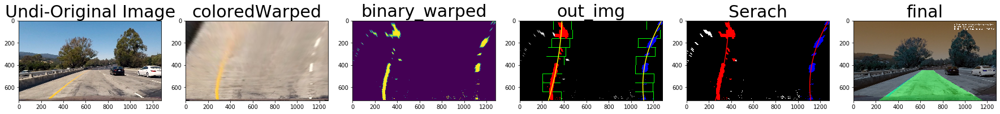

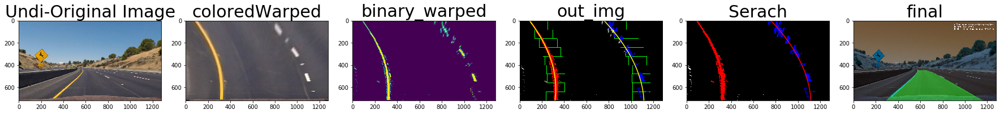

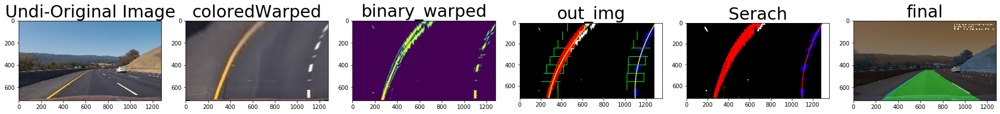

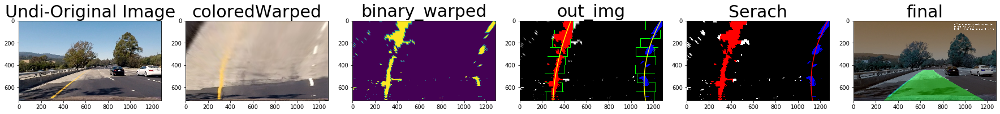

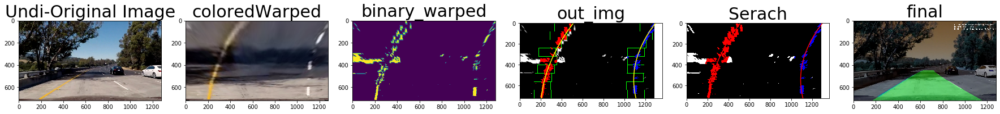

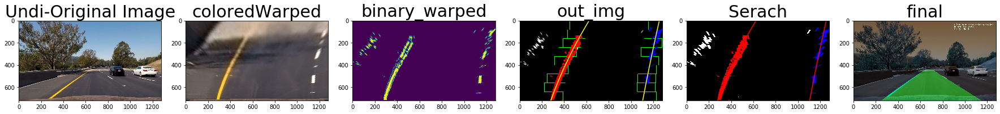

In [113]:

for image in glob.glob('test_images/test*.jpg'):
    image = cv2.imread(image)
    undismage = unDisImg(image,savedMtx,savedDist)
    masked = combinedThresholds(undismage, HLS = 0, Mode = 'all-A')
    M, unwrap_m = perspective_transform(image) 
    coloredWarped = warpedImage(image,M)
    binary_warped = warpedImage(masked,M)
    out_img, left_fitx,right_fitx, ploty, left_fit ,right_fit= fit_polynomial(binary_warped)
    region,left_fitx, right_fitx, ploty,left_fit,right_fit = search_around_poly(binary_warped, left_fit,right_fit)
    radius = measure_curvature_real(ploty, left_fitx,right_fitx)
    final = overlay(image,  left_fitx,right_fitx, radius, unwrap_m=unwrap_m)

    cv2.imshow("final",final)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    
    f, (ax1, ax2, ax3, ax4,ax5, ax6) = plt.subplots(1, 6,  figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(undismage, cv2.COLOR_BGR2RGB))
    ax1.set_title('Undi-Original Image', fontsize=30)
    ax2.imshow(cv2.cvtColor(coloredWarped, cv2.COLOR_BGR2RGB))
    ax2.set_title("coloredWarped", fontsize=30)
    ax3.imshow(binary_warped)
    ax3.set_title("binary_warped", fontsize=30)
    
    
    ax4.imshow(out_img)
    ax4.plot(left_fitx, ploty, color='yellow')
    ax4.plot(right_fitx, ploty, color='yellow')
    ax4.set_title("out_img", fontsize=30)
    
    

    ax5.imshow(region)
    ax5.plot(left_fitx, ploty, color='red')
    ax5.plot(right_fitx, ploty, color='red')
    ax5.set_title("Serach", fontsize=30)
    
    
    ax6.imshow(final)

    ax6.set_title("final", fontsize=30)
   

    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    


Writing the pipeline() function in a way that works for the first frame and other frames, where it can take the previous lane lines polynomials as input. 
this will help me writing the videoProcess() function.


In [133]:
def pipeline(image,savedMtx,savedDist, M, unwrapMtx, left_fit = None, right_fit = None , firstFrame = True):
    undismage = unDisImg(image,savedMtx,savedDist)
    masked = combinedThresholds(undismage, HLS = 1, Mode = 'all-OR')
    #coloredWarped, _ = perspective_transform(image)
    binary_warped = warpedImage(masked,M)
    if firstFrame:
        out_img, left_fitx,right_fitx, ploty, left_fit ,right_fit= fit_polynomial(binary_warped)
    else:
        _ ,left_fitx, right_fitx, ploty,left_fit,right_fit = search_around_poly(binary_warped,left_fit,right_fit)
    
    radius = measure_curvature_real(ploty,left_fitx,right_fitx)
    final = overlay(image, left_fitx,right_fitx, radius, unwrap_m=unwrapMtx )
    return final , right_fit, left_fit

Testing the pipeline function in single frame mode (firstFrame = True ) where it does not depend on a prevous info from other frames. 

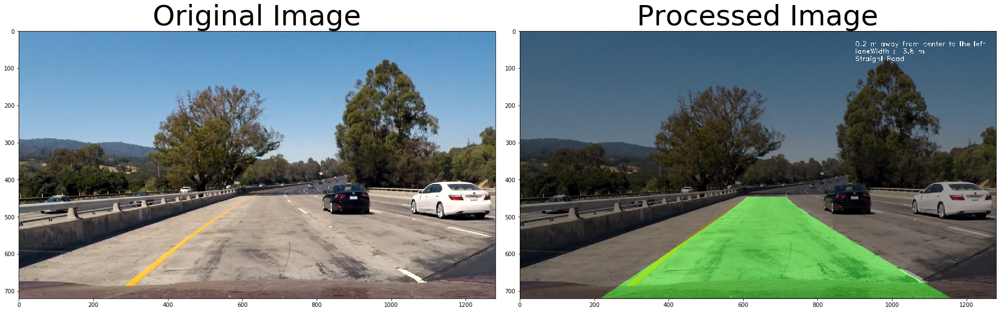

In [134]:
image = cv2.imread('test_images/test1.jpg')
M, unwrapMtx = perspective_transform(image)

final,  right_fit, left_fit = pipeline(image,savedMtx,savedDist,M, unwrapMtx, left_fit = None, right_fit = None , firstFrame = True)
subPlot1by2(image,final)

# cv2.imshow("combined",final)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

Copulating every thing in a single function to process the video, I am using OpenCV to read and write the video frames, Note that how I am using the pipeline() function for the first frame and the following frames (lines 25 and 46)

In line 42 you will see that I am using the pipeline() in firstFrame mode every 15 frames to update the searching windows in case we are shifting away.  


In [135]:
def videoProcess(videoPath, SaveTo = None):
    # Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
    vid = cv2.VideoCapture(videoPath)
    # Check if camera opened successfully
    if (vid.isOpened()== False): 
        print("Error opening video stream or file")
        


    #initalize windows for first frame
    M= None
    unwrapMtx = None
    right_fit = None
    left_fit = None
    width = None
    height = None
    UpdateRate = 15
    ret, frame = vid.read()

    if ret == True:
        M, unwrapMtx = perspective_transform(frame)
        height, width = frame.shape[:2] 
        #frame = cv2.resize(frame,(int(width*0.5),int(height*0.5)))
        outImg , right_fit, left_fit = pipeline(frame,savedMtx,savedDist, M, unwrapMtx, left_fit = None, right_fit = None , firstFrame = True)
    if SaveTo != None:
        out = cv2.VideoWriter((SaveTo + '.mp4'),cv2.VideoWriter_fourcc(*'MP4V'), 10, (width,height))

    frameCount = 0    
    # Read until video is completed
    while(vid.isOpened()):
        # Capture frame-by-frame
        ret, frame = vid.read()
        if ret == True:
            frameCount = frameCount + 1
            height, width = frame.shape[:2] 

            #frame = cv2.resize(frame,(int(width*0.5),int(height*0.5)))

            #outImg , right_fit, left_fit = pipeline(frame,savedMtx,savedDist, left_fit = None, right_fit = None , firstFrame = True)
            if frameCount% UpdateRate == 0:
                outImg , right_fit, left_fit = pipeline(frame,savedMtx,savedDist, M, unwrapMtx, left_fit = None, right_fit = None , firstFrame = True)
                draw_text(outImg, 'Updating windows', 10, 80)

            else:
                outImg , right_fit, left_fit = pipeline(frame,savedMtx,savedDist, M, unwrapMtx, left_fit = left_fit, right_fit = right_fit , firstFrame = False)
            # Display the resulting frame
            cv2.imshow('Frame',outImg)
            if SaveTo != None:
                out.write(outImg)

            # Press Q on keyboard to  exit
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break

        # Break the loop
        else: 
            break

    # When everything done, release the video capture object
    vid.release()
    if SaveTo != None:
        out.release()

    # Closes all the frames
    cv2.destroyAllWindows()

Testing the videoProcess() function using project_video.mp4 video and writing back to project_videoOut.mp4

In [136]:
videoProcess('./input_videos/project_video.mp4', "project_videoOut")

## Discussion
The pipeline worked very well for the easy video; project_video.mp4

In [141]:
from IPython.display import HTML

HTML("""
    <video alt="test" controls>
        <source src="project_videoOut.mp4" type="video/mp4">
    </video>
""")

The suggested pipeline from the lessons worked very well, but for the challenge videos the pipeline fails for shadows, and the road edges. 
A more robust pipeline is required here. Better binary masks might solve the issue I tried some combination listed above but they failed also. Maybe a Deep learning technique is required here. 

Overall I learned a lot doing this ProJet, I learned about the Pickle library also I learned how to pass a default parameter to a function which was so powerful.
